In [1]:
import numpy as np
from pymongo import MongoClient
import pandas as pd
import re
import string

from nltk.stem import WordNetLemmatizer
import nltk
nltk.download('wordnet')

import matplotlib.pyplot as plt

import nltk
from nltk.corpus import stopwords

[nltk_data] Downloading package wordnet to /home/ubuntu/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


### Load data from MongoDB in pandas dataframe

In [2]:
client = MongoClient()
client.list_database_names()

['admin', 'jobs_data', 'local']

In [3]:
db = client.jobs_data
collections = db.list_collection_names()
collections

['New_York_Jobs_Info',
 'Seattle_Jobs_Info',
 'Chicago_Jobs_Info',
 'SF_Bay_Area_Jobs_Info',
 'Los_Angeles_Jobs_Info']

In [4]:
cursor = db.New_York_Jobs_Info.find({}, 
    {'_id':0, 'url':1, 'job_title':1, 'company_name':1, 'listed_items':1})
ny_jobs = pd.DataFrame(list(cursor))
ny_jobs.head()

,company_name,job_title,listed_items,url
0,New York Stem Cell Foundation,"PhD Scientist, Neurodegenerative Disease Brain...",Develop and analyze 2D and 3D cellular models...,https://www.indeed.com/rc/clk?jk=60fa6b914b658...
1,,"Principal Data Scientist, Trial Planning & Ana...",,https://www.indeed.com/rc/clk?jk=e397a5515de9d...
2,Blue Mesa Health,Front-End Angular Developer,"Write, develop, analyze, and elevate code tha...",https://www.indeed.com/rc/clk?jk=9aa1678a96dd6...
3,Mayor's Office of Contract Services,"Analyst, Learning Management [JO 380385 & 378151]",Provide high-quality support for users of all ...,https://www.indeed.com/company/Mayor's-Office-...
4,Google,Application Engineer,,https://www.indeed.com/rc/clk?jk=54964eb2f65ca...


In [5]:
cursor = db.Seattle_Jobs_Info.find({}, 
    {'_id':0, 'url':1, 'job_title':1, 'company_name':1, 'listed_items':1})
sa_jobs = pd.DataFrame(list(cursor))
sa_jobs.head()

,company_name,job_title,listed_items,url
0,Facebook,"Software Engineer, People Search and Discovery",Develop highly scalable classifiers and tools...,https://www.indeed.com/rc/clk?jk=7baa212a615ae...
1,King County,PeopleSoft Security Engineer,"Play a pivotal role to modernize, standardize ...",https://www.indeed.com/rc/clk?jk=b06c9cda72c9d...
2,Deloitte,User Experience (UX) Designer - Seattle,Act as the contributing UX designer for high-...,https://www.indeed.com/rc/clk?jk=a3d5c3717aadd...
3,Amazon.com,"Sr Manager, Product Management",Manage 6-8 technical product managers and be r...,https://www.indeed.com/rc/clk?jk=ecea4f9d151af...
4,Zillow Group,"Senior Manager, Applied Scientist",Leading and growing a team of Applied Scienti...,https://www.indeed.com/rc/clk?jk=30e12db0cfaee...


In [6]:
cursor = db.Chicago_Jobs_Info.find({}, 
    {'_id':0, 'url':1, 'job_title':1, 'company_name':1, 'listed_items':1})
chi_jobs = pd.DataFrame(list(cursor))
chi_jobs.head()

,company_name,job_title,listed_items,url
0,SAP,SAP Concur Standard Serice Administrator,"As requested, communicate (via phone, chat or...",https://www.indeed.com/rc/clk?jk=c8edba7e5be63...
1,The Chicago Metropolitan Agency for Planning (...,Planning Principal Analyst (PPA219),"Staff Management including: assigns, directs,...",https://www.indeed.com/rc/clk?jk=c84075e51866d...
2,UChicago Medicine,Analytics Engineer,Data Pre-Processing: Manipulate data from sou...,https://www.indeed.com/rc/clk?jk=1dd42a91c7948...
3,Dart Container,Quality Technician,Requires one of the following: Associate’s de...,https://www.indeed.com/rc/clk?jk=2a71c2c760b8c...
4,Argonne National Laboratory,Lead Design Machinist,Interfaces with customers to achieve final ge...,https://www.indeed.com/rc/clk?jk=085258c999811...


In [7]:
cursor = db.SF_Bay_Area_Jobs_Info.find({}, 
    {'_id':0, 'url':1, 'job_title':1, 'company_name':1, 'listed_items':1})
sfba_jobs = pd.DataFrame(list(cursor))
sfba_jobs.head()

,company_name,job_title,listed_items,url
0,Gap Inc. Corporate,"Software Engineer, Price Execution",Write code to build products according to bus...,https://www.indeed.com/rc/clk?jk=77d524a7cf198...
1,WrkShp,Business Analyst,Work closely with product and assist them in i...,https://www.indeed.com/company/WrkShp/jobs/Bus...
2,Ceres Imaging,Image Processing: GIS / Remote Sensing Analyst,"Proficiency in GIS software (e.g., ArcGIS, EN...",https://www.indeed.com/rc/clk?jk=8f702cd563785...
3,Deloitte,"Analyst, Strategy and Research",Effectively interpret client requests and use...,https://www.indeed.com/rc/clk?jk=8a288a5c5a09d...
4,Turing Video,Computer Vision Software Engineer,To maintain the existing software and systems....,https://www.indeed.com/rc/clk?jk=fcf308f2fee2a...


In [8]:
cursor = db.Los_Angeles_Jobs_Info.find({}, 
    {'_id':0, 'url':1, 'job_title':1, 'company_name':1, 'listed_items':1})
la_jobs = pd.DataFrame(list(cursor))
la_jobs.head()

,company_name,job_title,listed_items,url
0,The Aerospace Corporation,"Electrical Engineer, 2019 Graduate Intern",Perform electrical engineering evaluations at ...,https://www.indeed.com/rc/clk?jk=9183e76f1da84...
1,Electronic Arts,Sr. BA Analyst - Respawn,Influence development decisions and marketing...,https://www.indeed.com/rc/clk?jk=9fad44d638c23...
2,Sony Interactive Entertainment PlayStation,Software Engineer II,Write Java code for internal application devel...,https://www.indeed.com/rc/clk?jk=40376ba33c6f4...
3,ZEFR,Software Engineer II,"Languages: Python, Scala, and Kotlin. Data sto...",https://www.indeed.com/rc/clk?jk=6622088b95284...
4,,"Marketing Analyst, Retention","Analyze customer demographic, behavioral and o...",https://www.indeed.com/rc/clk?jk=d925d6d9d2900...


In [9]:
df = pd.concat([ny_jobs, sfba_jobs, chi_jobs, sa_jobs, la_jobs])
df.head()

,company_name,job_title,listed_items,url
0,New York Stem Cell Foundation,"PhD Scientist, Neurodegenerative Disease Brain...",Develop and analyze 2D and 3D cellular models...,https://www.indeed.com/rc/clk?jk=60fa6b914b658...
1,,"Principal Data Scientist, Trial Planning & Ana...",,https://www.indeed.com/rc/clk?jk=e397a5515de9d...
2,Blue Mesa Health,Front-End Angular Developer,"Write, develop, analyze, and elevate code tha...",https://www.indeed.com/rc/clk?jk=9aa1678a96dd6...
3,Mayor's Office of Contract Services,"Analyst, Learning Management [JO 380385 & 378151]",Provide high-quality support for users of all ...,https://www.indeed.com/company/Mayor's-Office-...
4,Google,Application Engineer,,https://www.indeed.com/rc/clk?jk=54964eb2f65ca...


### Remove non-word/number characters and make lower

In [10]:
alphanumeric = lambda x: re.sub('[\W_]+', ' ', x)
punc_lower = lambda x: re.sub('[%s]' % re.escape(string.punctuation), ' ', x.lower())

df['listed_items'] = df.listed_items.map(alphanumeric).map(punc_lower)
df.head()

,company_name,job_title,listed_items,url
0,New York Stem Cell Foundation,"PhD Scientist, Neurodegenerative Disease Brain...",develop and analyze 2d and 3d cellular models...,https://www.indeed.com/rc/clk?jk=60fa6b914b658...
1,,"Principal Data Scientist, Trial Planning & Ana...",,https://www.indeed.com/rc/clk?jk=e397a5515de9d...
2,Blue Mesa Health,Front-End Angular Developer,write develop analyze and elevate code that i...,https://www.indeed.com/rc/clk?jk=9aa1678a96dd6...
3,Mayor's Office of Contract Services,"Analyst, Learning Management [JO 380385 & 378151]",provide high quality support for users of all ...,https://www.indeed.com/company/Mayor's-Office-...
4,Google,Application Engineer,,https://www.indeed.com/rc/clk?jk=54964eb2f65ca...


Some fields are blank so we'll just get rid of them.

In [11]:
blank_indeces = df[df.listed_items==''].index
df = df.drop(blank_indeces)

### Remove common english stop words

In [12]:
stop = set(stopwords.words('english'))

In [13]:
df['listed_items'] = df.listed_items.apply(lambda x: 
                [item for item in x.split() if item not in stop])
df['listed_items'] = df.listed_items.str.join(' ')
df.head()

,company_name,job_title,listed_items,url
0,New York Stem Cell Foundation,"PhD Scientist, Neurodegenerative Disease Brain...",develop analyze 2d 3d cellular models neurodeg...,https://www.indeed.com/rc/clk?jk=60fa6b914b658...
2,Blue Mesa Health,Front-End Angular Developer,write develop analyze elevate code well struct...,https://www.indeed.com/rc/clk?jk=9aa1678a96dd6...
3,Mayor's Office of Contract Services,"Analyst, Learning Management [JO 380385 & 378151]",provide high quality support users city procur...,https://www.indeed.com/company/Mayor's-Office-...
5,ADP,Senior Strategy Analyst,structure solutions complex business problems ...,https://www.indeed.com/rc/clk?jk=bb01d61a65e12...
7,Avanade,Azure Data Engineer,translate business requirements technical solu...,https://www.indeed.com/rc/clk?jk=e6b5fa9fc5b0e...


### Find and remove stopwords specific to my dataset

In [14]:
from wordcloud import WordCloud

wc = WordCloud(background_color='white', colormap='Dark2', 
               max_font_size=150, random_state=10)

ValueError: num must be 1 <= num <= 465, not 466

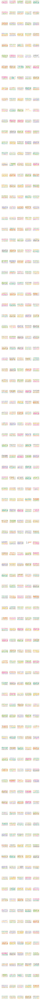

In [15]:
plt.figure(figsize=(15,400))

for i, item in enumerate(df.listed_items):
    wc.generate(item)

    plt.subplot(93, 5, i+1)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    
plt.show()

In [16]:
new_stop_words = ['data', 'code', 'team']
df['listed_items'] = df.listed_items.apply(lambda x: 
                [item for item in x.split() if item not in new_stop_words])
df['listed_items'] = df.listed_items.str.join(' ')
df.head()

,company_name,job_title,listed_items,url
0,New York Stem Cell Foundation,"PhD Scientist, Neurodegenerative Disease Brain...",develop analyze 2d 3d cellular models neurodeg...,https://www.indeed.com/rc/clk?jk=60fa6b914b658...
2,Blue Mesa Health,Front-End Angular Developer,write develop analyze elevate well structured ...,https://www.indeed.com/rc/clk?jk=9aa1678a96dd6...
3,Mayor's Office of Contract Services,"Analyst, Learning Management [JO 380385 & 378151]",provide high quality support users city procur...,https://www.indeed.com/company/Mayor's-Office-...
5,ADP,Senior Strategy Analyst,structure solutions complex business problems ...,https://www.indeed.com/rc/clk?jk=bb01d61a65e12...
7,Avanade,Azure Data Engineer,translate business requirements technical solu...,https://www.indeed.com/rc/clk?jk=e6b5fa9fc5b0e...


### Stemming and Lemmatization

In [17]:
lem = WordNetLemmatizer()

In [18]:
def description_lemmatizer(description):
    tokens = description.split()
    stemmed_tokens = [lem.lemmatize(token) for token in tokens]
    return ' '.join(stemmed_tokens)

In [19]:
df['listed_items'] = df.listed_items.apply(description_lemmatizer)
df.head()

,company_name,job_title,listed_items,url
0,New York Stem Cell Foundation,"PhD Scientist, Neurodegenerative Disease Brain...",develop analyze 2d 3d cellular model neurodege...,https://www.indeed.com/rc/clk?jk=60fa6b914b658...
2,Blue Mesa Health,Front-End Angular Developer,write develop analyze elevate well structured ...,https://www.indeed.com/rc/clk?jk=9aa1678a96dd6...
3,Mayor's Office of Contract Services,"Analyst, Learning Management [JO 380385 & 378151]",provide high quality support user city procure...,https://www.indeed.com/company/Mayor's-Office-...
5,ADP,Senior Strategy Analyst,structure solution complex business problem pr...,https://www.indeed.com/rc/clk?jk=bb01d61a65e12...
7,Avanade,Azure Data Engineer,translate business requirement technical solut...,https://www.indeed.com/rc/clk?jk=e6b5fa9fc5b0e...


ValueError: num must be 1 <= num <= 1000, not 1001

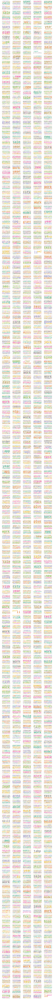

In [20]:
plt.rcParams['figure.figsize'] = [15,300]

for i, item in enumerate(df.listed_items):
    wc.generate(item)

    plt.subplot(200, 5, i+1)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    
plt.show()

In [21]:
new_stop_words = ['work']
df['listed_items'] = df.listed_items.apply(lambda x: 
                [item for item in x.split() if item not in new_stop_words])
df['listed_items'] = df.listed_items.str.join(' ')
df.head()

,company_name,job_title,listed_items,url
0,New York Stem Cell Foundation,"PhD Scientist, Neurodegenerative Disease Brain...",develop analyze 2d 3d cellular model neurodege...,https://www.indeed.com/rc/clk?jk=60fa6b914b658...
2,Blue Mesa Health,Front-End Angular Developer,write develop analyze elevate well structured ...,https://www.indeed.com/rc/clk?jk=9aa1678a96dd6...
3,Mayor's Office of Contract Services,"Analyst, Learning Management [JO 380385 & 378151]",provide high quality support user city procure...,https://www.indeed.com/company/Mayor's-Office-...
5,ADP,Senior Strategy Analyst,structure solution complex business problem pr...,https://www.indeed.com/rc/clk?jk=bb01d61a65e12...
7,Avanade,Azure Data Engineer,translate business requirement technical solut...,https://www.indeed.com/rc/clk?jk=e6b5fa9fc5b0e...


In [22]:
df.to_pickle('../Data/00_clean_data')